In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from torchvision import datasets, transforms
from PIL import Image
from collections import Counter
from torchvision.datasets import ImageFolder
import pandas as pd
from tqdm import tqdm
import requests

In [2]:
train_dir = "/kaggle/input/cards-image-datasetclassification/train"
valid_dir = "/kaggle/input/cards-image-datasetclassification/valid"
test_dir = "/kaggle/input/cards-image-datasetclassification/test"

In [3]:
custom_test_dir = "/kaggle/input/custom-test-data/custom_test_data"

In [4]:
# Defining parameters
batch_size = 32
image_size = (224, 224)
num_classes = 53
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CNNModel(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.conv1   = nn.Conv2d(3, 32, 5)
        self.pool    = nn.MaxPool2d(2,2)  
        self.batch1  = nn.BatchNorm2d(32)
        self.conv2   = nn.Conv2d(32, 32, 5) 
        self.batch2  = nn.BatchNorm2d(32)
        self.conv3   = nn.Conv2d(32,24, 5, stride=2, padding=1)
        self.batch3  = nn.BatchNorm2d(24)
        
        self.f1      = nn.Linear(24*13*13, 128)
        self.batchL1 = nn.BatchNorm1d(128)
        self.f2      = nn.Linear(128, 64)
        self.batchL2 = nn.BatchNorm1d(64)
        self.f3      = nn.Linear(64, num_classes)
        self.dropout = nn.Dropout(0.2)

    def forward(self, x):
        
        x = self.pool(F.relu(self.conv1(x)))
        x = self.batch1(x)
        x = self.pool(F.relu(self.conv2(x)))
        x = self.batch2(x)
        x = self.pool(F.relu(self.conv3(x)))
        x = self.batch3(x)
        x = self.dropout(x)
        
        x = x.view(-1, 24*13*13)
        
        x = F.relu(self.f1(x))
        x = self.batchL1(x)
        x = F.relu(self.f2(x))
        x = self.batchL2(x)
        x = self.dropout(x)
        x = self.f3(x)
        return x

In [6]:
class_labels = ['ace of clubs', 'ace of diamonds', 'ace of hearts', 'ace of spades', 'eight of clubs', 'eight of diamonds', 'eight of hearts', 'eight of spades', 'five of clubs', 'five of diamonds', 'five of hearts', 'five of spades', 'four of clubs', 'four of diamonds', 'four of hearts', 'four of spades', 'jack of clubs', 'jack of diamonds', 'jack of hearts', 'jack of spades', 'joker', 'king of clubs', 'king of diamonds', 'king of hearts', 'king of spades', 'nine of clubs', 'nine of diamonds', 'nine of hearts', 'nine of spades', 'queen of clubs', 'queen of diamonds', 'queen of hearts', 'queen of spades', 'seven of clubs', 'seven of diamonds', 'seven of hearts', 'seven of spades', 'six of clubs', 'six of diamonds', 'six of hearts', 'six of spades', 'ten of clubs', 'ten of diamonds', 'ten of hearts', 'ten of spades', 'three of clubs', 'three of diamonds', 'three of hearts', 'three of spades', 'two of clubs', 'two of diamonds', 'two of hearts', 'two of spades']

In [7]:
# Data transformation for images
data_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

### Prediction on Custom test data

In [8]:
# Function to classify images in a folder and calculate accuracy
def classify_images_in_folder(model, dir_path, class_labels, transform, device):
    # Load model
    model.to(device)
    model.eval()

    correct = 0
    total = 0
    incorrect_preds = []

    for image_name in os.listdir(dir_path):
        image_path = os.path.join(dir_path, image_name)
        try:
            # Load and preprocess the image
            image = Image.open(image_path).convert("RGB")
            input_tensor = transform(image).unsqueeze(0).to(device)

            # Run prediction
            with torch.no_grad():
                output = model(input_tensor)
                predicted_label_idx = torch.argmax(output, dim=1).item()

            # Ground truth from file name (assuming labels are part of the filename)
            ground_truth_label = image_name.split(".")[0].lower()  # Adjust according to filename convention
            predicted_label = class_labels[predicted_label_idx]

            # Update accuracy
            if ground_truth_label == predicted_label.lower():
                correct += 1
            else:
                incorrect_preds.append((image_path, ground_truth_label, predicted_label))

            total += 1

        except Exception as e:
            print(f"Error processing image {image_name}: {e}")
            continue

    accuracy = (correct / total) * 100 if total > 0 else 0
    print(f"Accuracy: {accuracy:.2f}%")
    return accuracy, incorrect_preds

In [9]:
# Function to display incorrectly classified images
def display_incorrect_predictions_in_folder(incorrect_preds):
    for image_path, ground_truth, predicted_label in incorrect_preds:
        # Load image
        image = Image.open(image_path).convert("RGB")

        # Plot image
        plt.figure(figsize=(4, 4))
        plt.imshow(image)
        plt.title(f"Ground Truth: {ground_truth}\nPredicted: {predicted_label}")
        plt.axis("off")
        plt.show()

In [10]:
# Instantiate the model and check
model_1 = CNNModel(num_classes=num_classes)
model_1.load_state_dict(torch.load("/kaggle/input/cnn/pytorch/default/1/cnn_v3.pt", map_location=torch.device('cpu')))
model_1 = model_1.to(device)

<ipython-input-10-6cf9e018a1d6>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_1.load_state_dict(torch.load("/kaggle/input/cnn/pytorch/default/1/cnn_v3.pt", map_loca

In [11]:
# Classify images and calculate accuracy
accuracy, incorrect_preds = classify_images_in_folder(model_1, custom_test_dir, class_labels, data_transform, device)

# Display incorrectly predicted images
display_incorrect_predictions_in_folder(incorrect_preds)

Accuracy: 100.00%


In [12]:
# Instantiate the model and check
model_2 = CNNModel(num_classes=num_classes)
model_2.load_state_dict(torch.load("/kaggle/input/cnn/pytorch/default/1/cnn_v4.pt", map_location=torch.device('cpu')))
model_2 = model_2.to(device)

<ipython-input-12-9feeee4d7b5d>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_2.load_state_dict(torch.load("/kaggle/input/cnn/pytorch/default/1/cnn_v4.pt", map_loca

In [13]:
# Classify images and calculate accuracy
accuracy, incorrect_preds = classify_images_in_folder(model_1, custom_test_dir, class_labels, data_transform, device)

# Display incorrectly predicted images
display_incorrect_predictions_in_folder(incorrect_preds)

Accuracy: 100.00%


### Exploratory Data Analysis

In [14]:
def count_images_in_dir(directory):
    class_counts = {}
    for class_dir in os.listdir(directory):
        class_path = os.path.join(directory, class_dir)
        if os.path.isdir(class_path):
            class_counts[class_dir] = len(os.listdir(class_path))
    return class_counts

# Count images
train_counts = count_images_in_dir(train_dir)
valid_counts = count_images_in_dir(valid_dir)
test_counts = count_images_in_dir(test_dir)

print(f"Number of classes in training set: {len(train_counts)}")
print(f"Number of images in training set: {sum(train_counts.values())}")
print(f"Number of images in validation set: {sum(valid_counts.values())}")
print(f"Number of images in test set: {sum(test_counts.values())}")

Number of classes in training set: 53
Number of images in training set: 7624
Number of images in validation set: 265
Number of images in test set: 265


In [15]:
# Plot class distribution
def plot_class_distribution(data_counts, title):
    classes, counts = zip(*sorted(data_counts.items()))
    counts = list(map(int, counts))  # Convert counts to integers if they are not already
    max_count = max(data_counts.values())
    min_count = min(data_counts.values())
    
    plt.figure(figsize=(14, 6))
    sns.barplot(x=list(classes), y=counts, palette="viridis")  # Convert classes to list
    plt.xticks(rotation=90)
    plt.title(title)
    plt.xlabel("Card Type")
    plt.ylabel("Image Count")
    plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


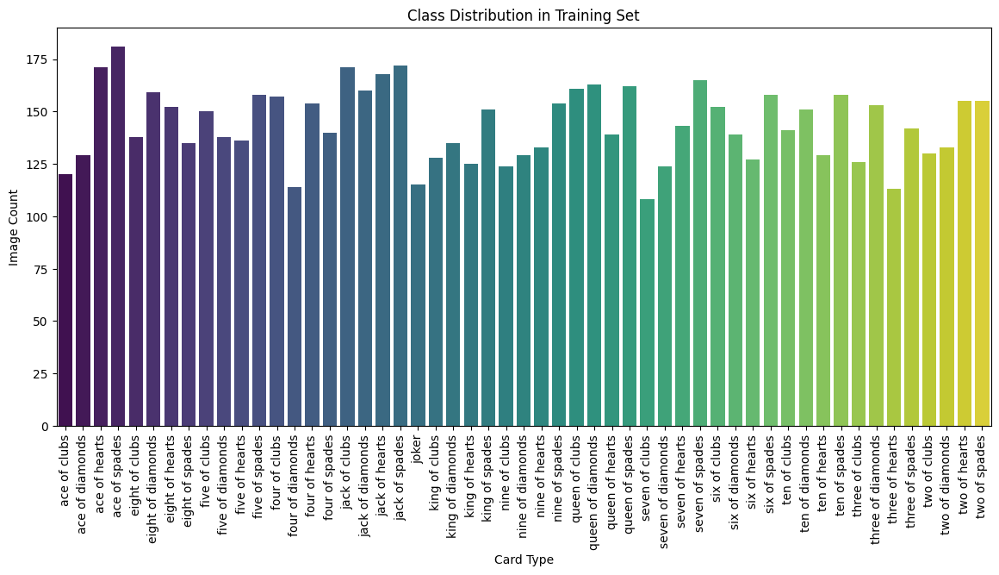

In [16]:
plot_class_distribution(train_counts, "Class Distribution in Training Set")

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


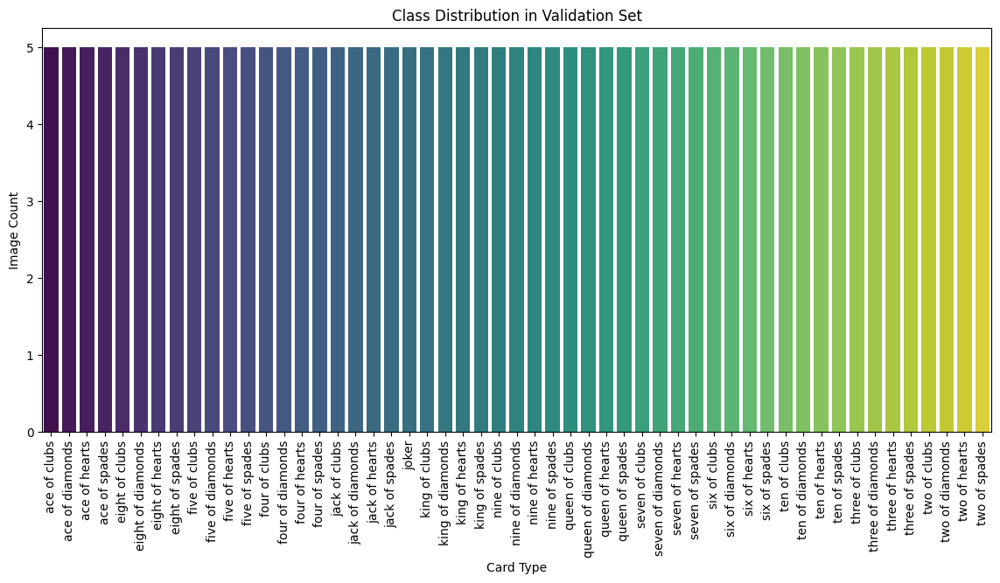

In [17]:
plot_class_distribution(valid_counts, "Class Distribution in Validation Set")

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


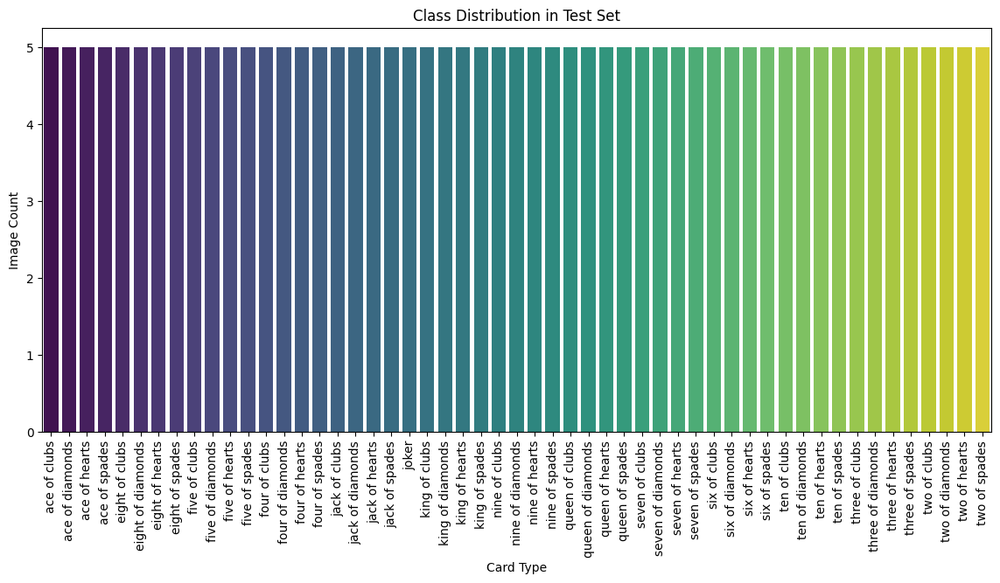

In [18]:
plot_class_distribution(test_counts, "Class Distribution in Test Set")

In [19]:
def check_data_balance(data_counts):
    counts = list(data_counts.values())
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=counts)
    plt.title("Distribution of Image Counts per Class")
    plt.xlabel("Image Counts")
    plt.show()

    print(f"Minimum images per class: {min(counts)}")
    print(f"Maximum images per class: {max(counts)}")
    print(f"Mean images per class: {np.mean(counts):.2f}")
    print(f"Standard deviation: {np.std(counts):.2f}")

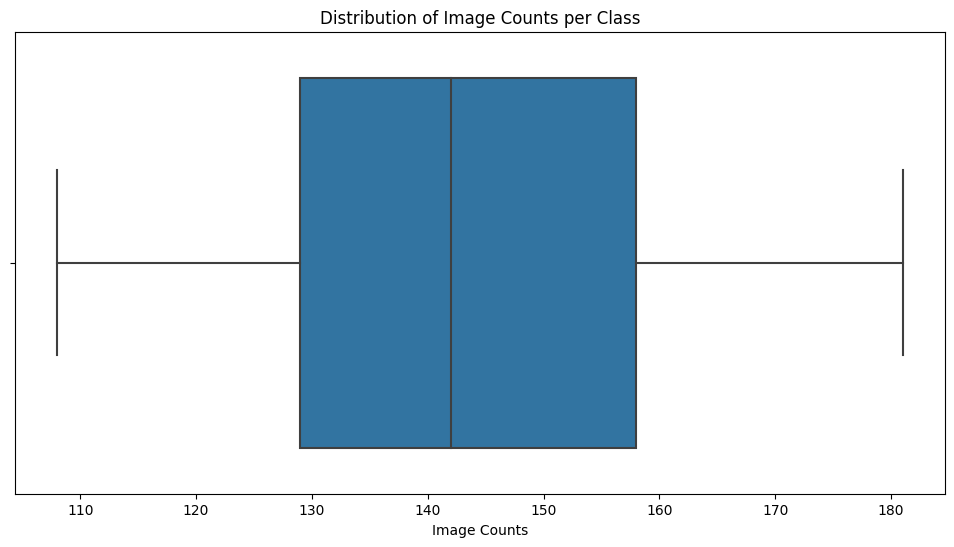

Minimum images per class: 108
Maximum images per class: 181
Mean images per class: 143.85
Standard deviation: 17.22


In [20]:
check_data_balance(train_counts)

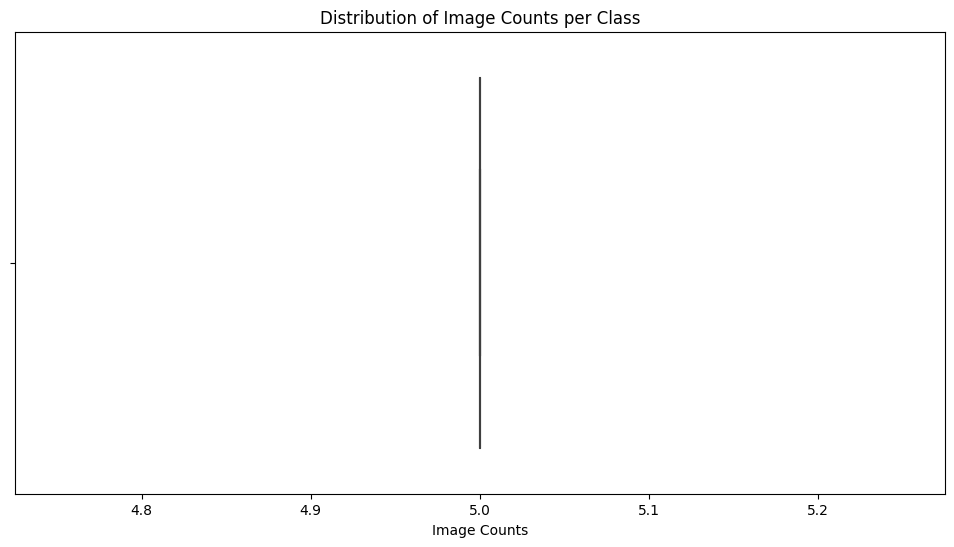

Minimum images per class: 5
Maximum images per class: 5
Mean images per class: 5.00
Standard deviation: 0.00


In [21]:
check_data_balance(valid_counts)

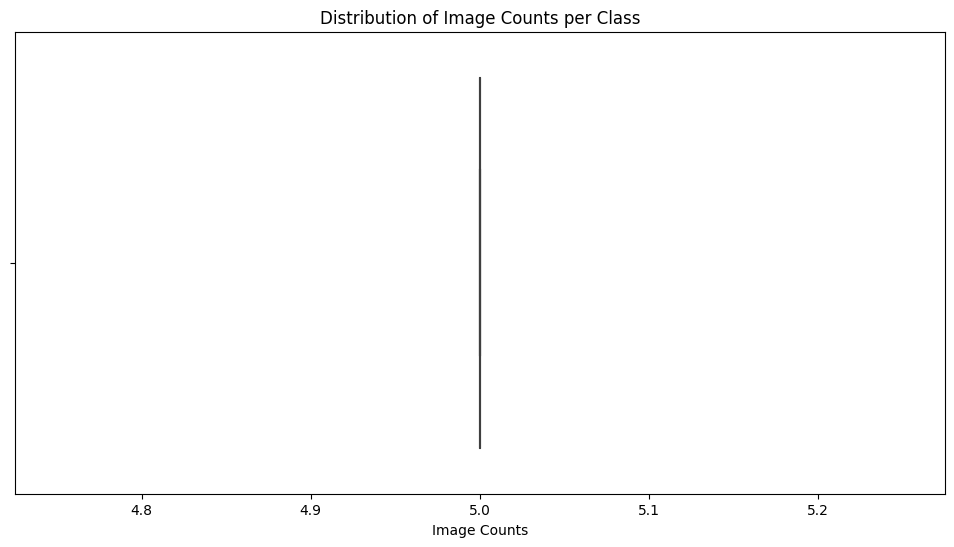

Minimum images per class: 5
Maximum images per class: 5
Mean images per class: 5.00
Standard deviation: 0.00


In [22]:
check_data_balance(test_counts)

In [23]:
def analyze_color_distribution(directory, num_samples=100):
    red_values, green_values, blue_values = [], [], []
    sample_count = 0

    for class_dir in os.listdir(directory):
        class_path = os.path.join(directory, class_dir)
        if os.path.isdir(class_path):
            for img_file in os.listdir(class_path):
                if sample_count >= num_samples:
                    break
                img_path = os.path.join(class_path, img_file)
                img = Image.open(img_path).convert("RGB")
                red, green, blue = img.split()
                red_values.append(np.mean(red))
                green_values.append(np.mean(green))
                blue_values.append(np.mean(blue))
                sample_count += 1

    # Plot color distributions
    plt.figure(figsize=(12, 6))
    sns.histplot(blue_values, color='blue', label="Blue Channel", element="poly")
    sns.histplot(green_values, color='green', label="Green Channel", element="poly")
    sns.histplot(red_values, color='red', label="Red Channel", element="poly")
    plt.title("Color Channel Distribution")
    plt.xlabel("Intensity")
    plt.ylabel("Frequency")
    plt.legend()
    plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


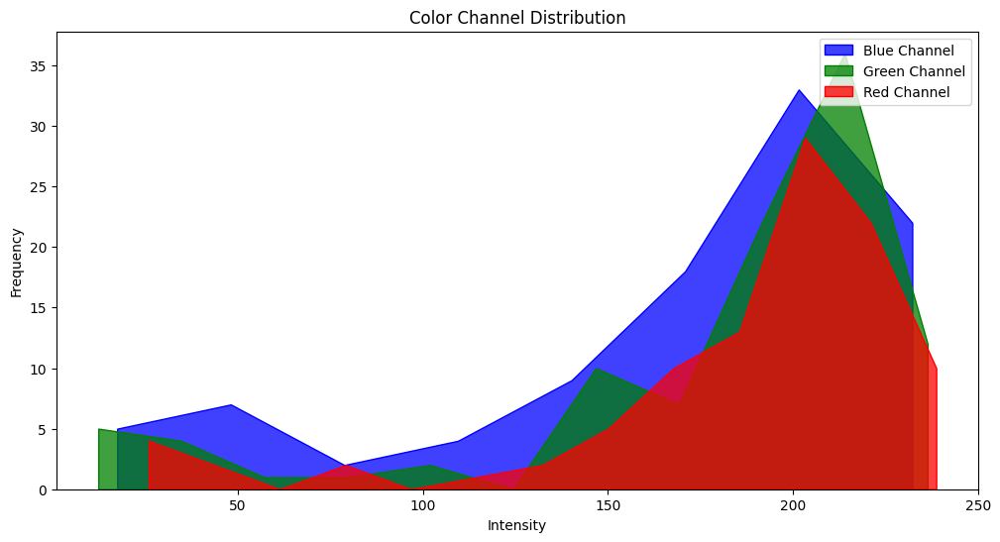

In [24]:
analyze_color_distribution(train_dir)

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


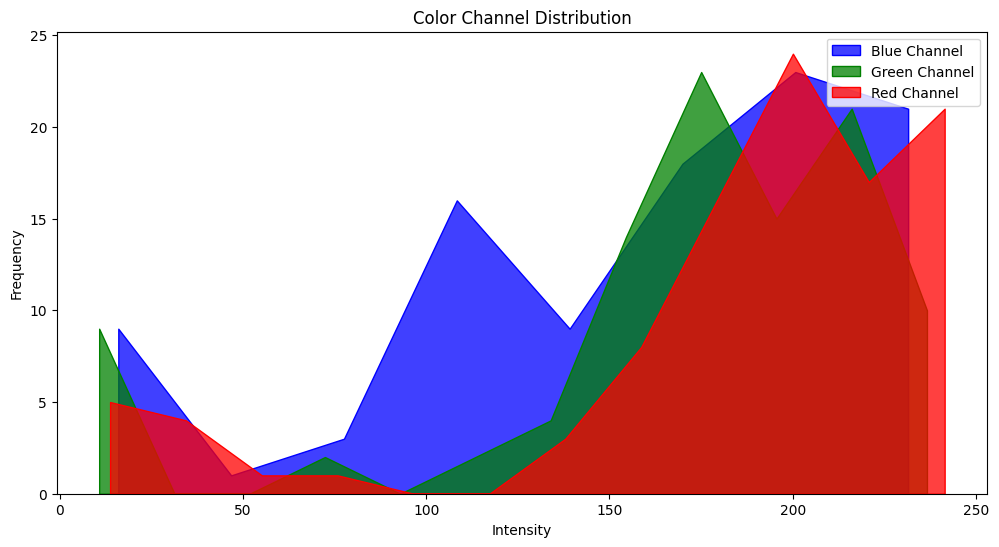

In [25]:
analyze_color_distribution(test_dir)

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


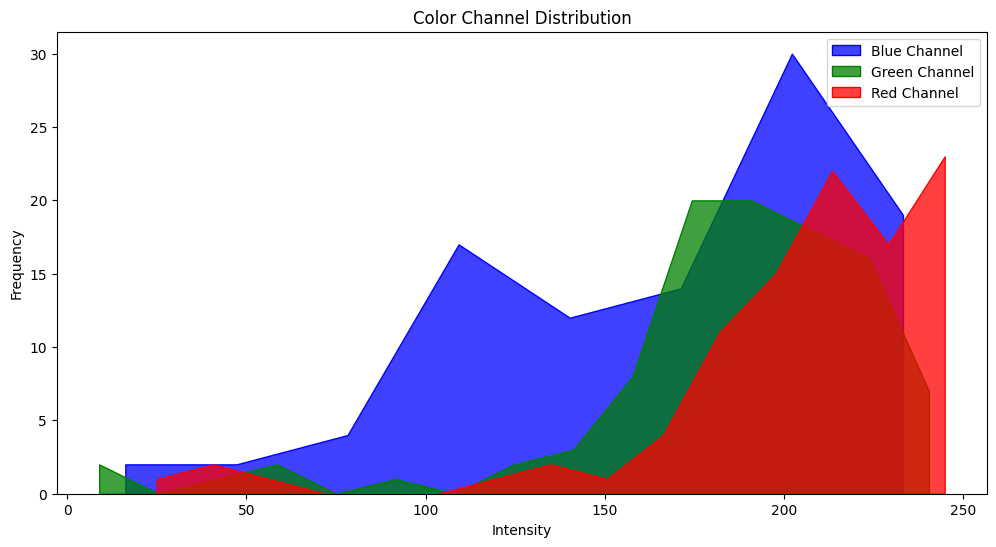

In [26]:
analyze_color_distribution(valid_dir)

In [27]:
def load_data(data_dir):
    dataset = datasets.ImageFolder(root=data_dir, transform=data_transform)
    return DataLoader(dataset, batch_size=32, shuffle=False)

In [28]:
train_loader = load_data(train_dir)
test_loader = load_data(test_dir)
valid_loader = load_data(valid_dir)

In [29]:
def get_prediction(data_loader, model):
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in data_loader:
            images = images.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    return all_preds, all_labels

### Model 1

#### Test data

In [30]:
all_preds, all_labels = get_prediction(test_loader, model_1)

In [31]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

In [32]:
def plot_confusion_matrix(cm, class_names):
    plt.figure(figsize=(20, 16))  # Increase figure size
    # sns.set(font_scale=0.8)  # Adjust font scale for better readability
    ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names, cbar=True)  # Adjust annotation font size
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for space
    # plt.yticks(fontsize=10)  # Adjust y-axis label size
    plt.tight_layout()  # Automatically adjust to prevent label cutoff
    plt.show()

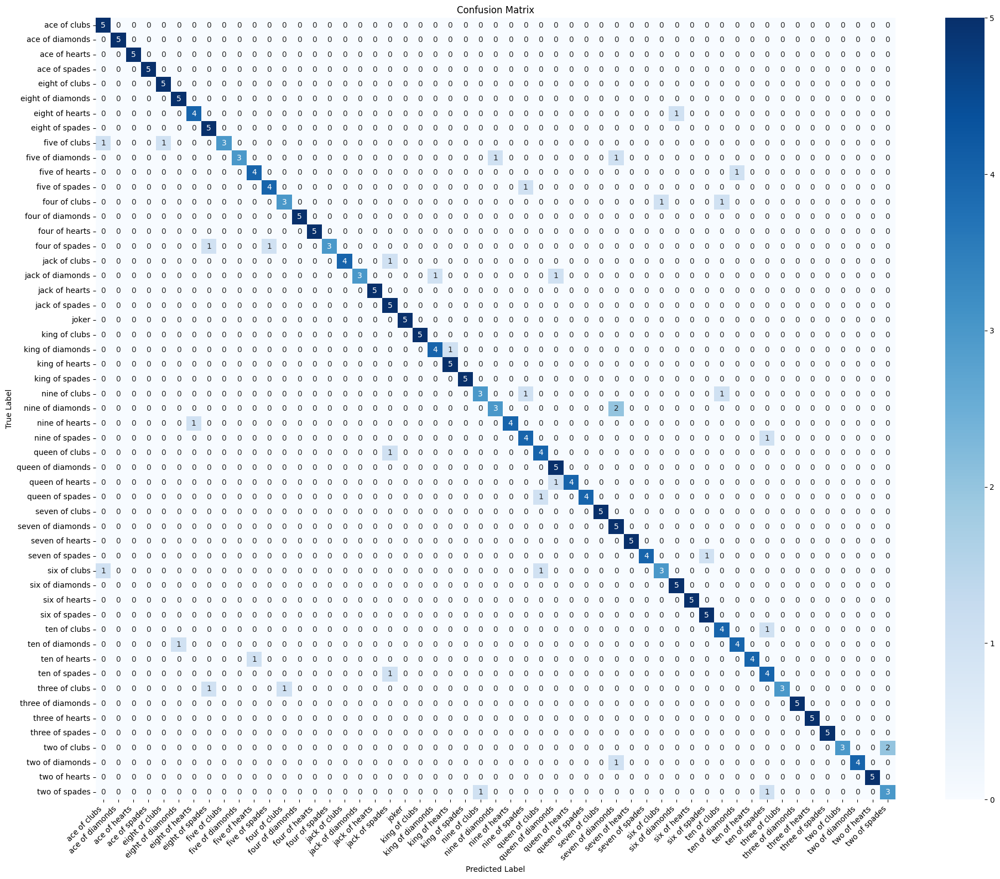

In [33]:
plot_confusion_matrix(confusion_mtx, class_labels)

In [34]:
def display_incorrect_predictions(model, data_loader, class_names, device):
    """
    Displays incorrectly predicted images with their ground truth and predicted labels.
    
    Args:
        model (torch.nn.Module): The trained model.
        data_loader (torch.utils.data.DataLoader): DataLoader for the dataset (train/valid/test).
        class_names (list): List of class names corresponding to label indices.
        device (torch.device): The device to run the model on (CPU or GPU).
    """
    model.eval()  # Set the model to evaluation mode
    incorrect_images = []
    incorrect_ground_truth = []
    incorrect_predictions = []
    total = 0
    with torch.no_grad():
        for images, labels in tqdm(data_loader):
            images, labels = images.to(device), labels.to(device)
            total += len(images)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)  # Get the predicted class
            
            # Find incorrect predictions
            incorrect_mask = predicted != labels
            incorrect_images.extend(images[incorrect_mask].cpu())
            incorrect_ground_truth.extend(labels[incorrect_mask].cpu())
            incorrect_predictions.extend(predicted[incorrect_mask].cpu())

    # Plot the incorrect predictions
    num_images = len(incorrect_images)
    print(f"Number of incorrect predictions: {num_images}")
    print(f"Total Number of Predictions: {total}")
    accuracy = 100 - ((num_images / total) * 100 if total > 0 else 0)
    print(f"Accuracy: {accuracy:.2f}%")
    if num_images == 0:
        print("No incorrect predictions found.")
        return

    # Define the number of images to display
    num_rows = num_images // 5 + (1 if num_images%5 != 0 else 0)
    num_cols = 5  # Display up to 5 columns
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 3 * num_rows))

    for i, ax in enumerate(axes.flatten()[:num_images]):
        img = incorrect_images[i].permute(1, 2, 0)  # Change dimensions for plotting
        ax.imshow(img.numpy())
        ax.set_title(f"actual: {class_names[incorrect_ground_truth[i]]}\nPred: {class_names[incorrect_predictions[i]]}")
        ax.axis("off")

    plt.tight_layout()
    plt.show()

100%|██████████| 9/9 [00:08<00:00,  1.04it/s]


Number of incorrect predictions: 38
Total Number of Predictions: 265
Accuracy: 85.66%


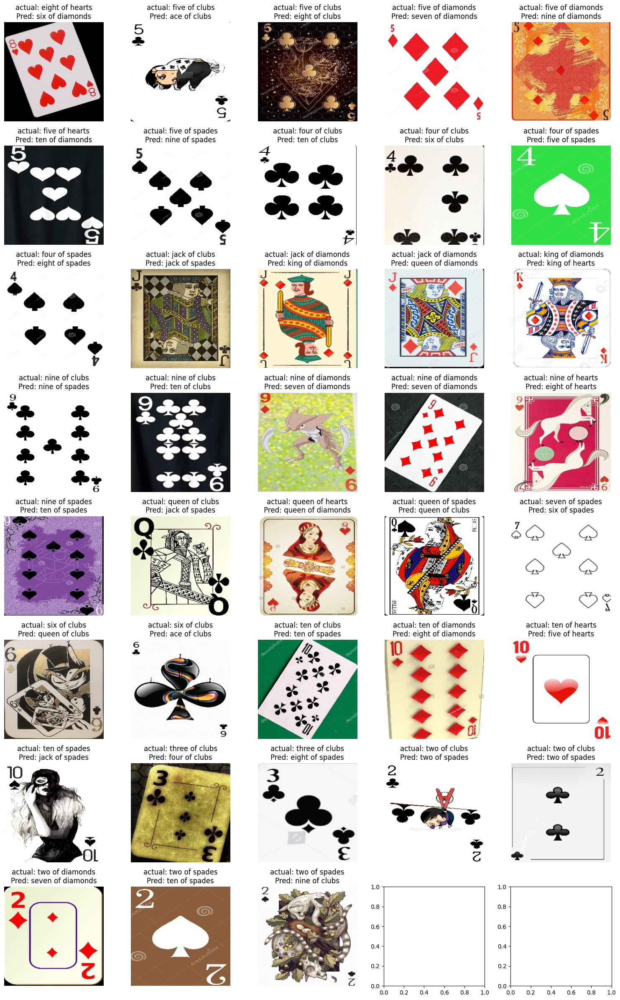

In [35]:
display_incorrect_predictions(
    model=model_1,
    data_loader=test_loader,
    class_names=class_labels,
    device=device
)

#### Validation data

In [36]:
all_preds, all_labels = get_prediction(valid_loader, model_1)

In [37]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

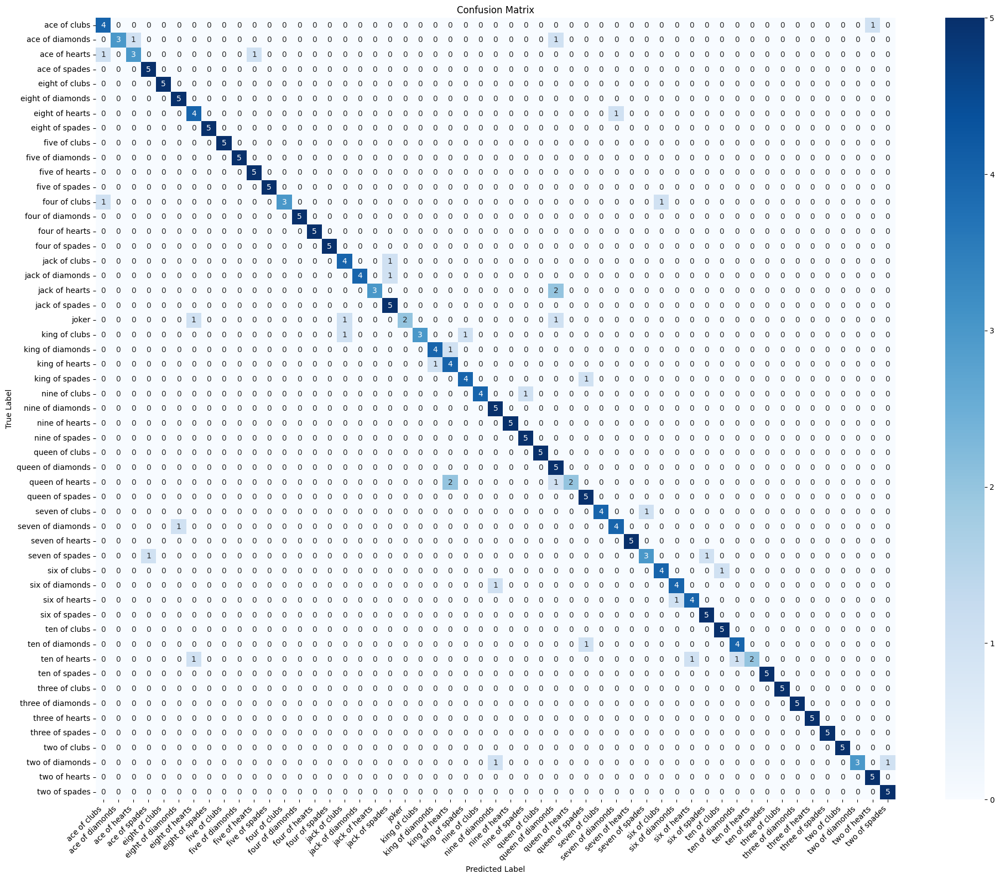

In [38]:
plot_confusion_matrix(confusion_mtx, class_labels)

100%|██████████| 9/9 [00:08<00:00,  1.06it/s]


Number of incorrect predictions: 37
Total Number of Predictions: 265
Accuracy: 86.04%


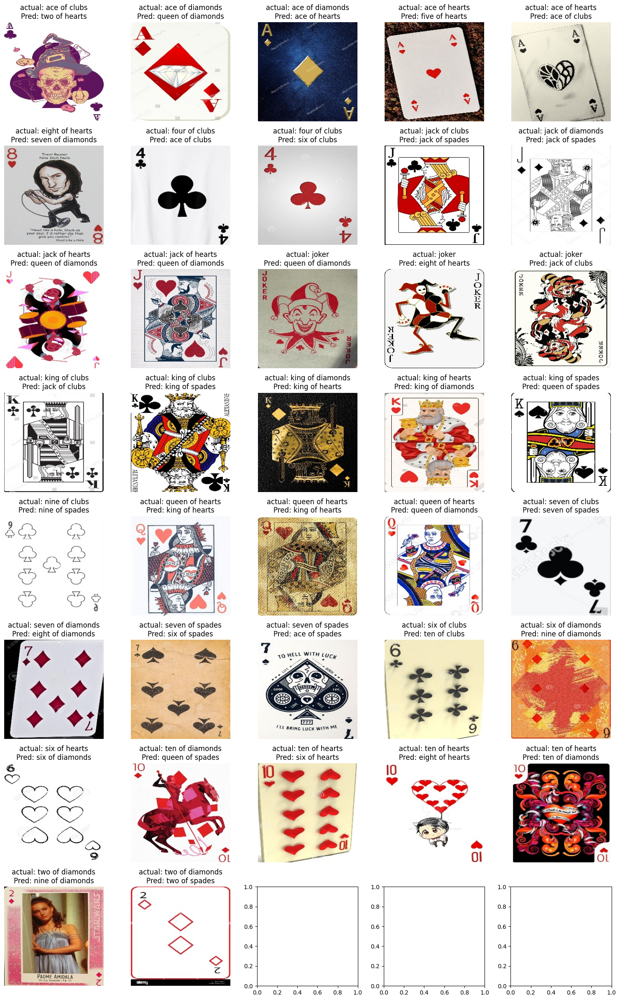

In [39]:
display_incorrect_predictions(
    model=model_1,
    data_loader=valid_loader,
    class_names=class_labels,
    device=device
)

#### training data

In [40]:
all_preds, all_labels = get_prediction(train_loader, model_1)

In [41]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

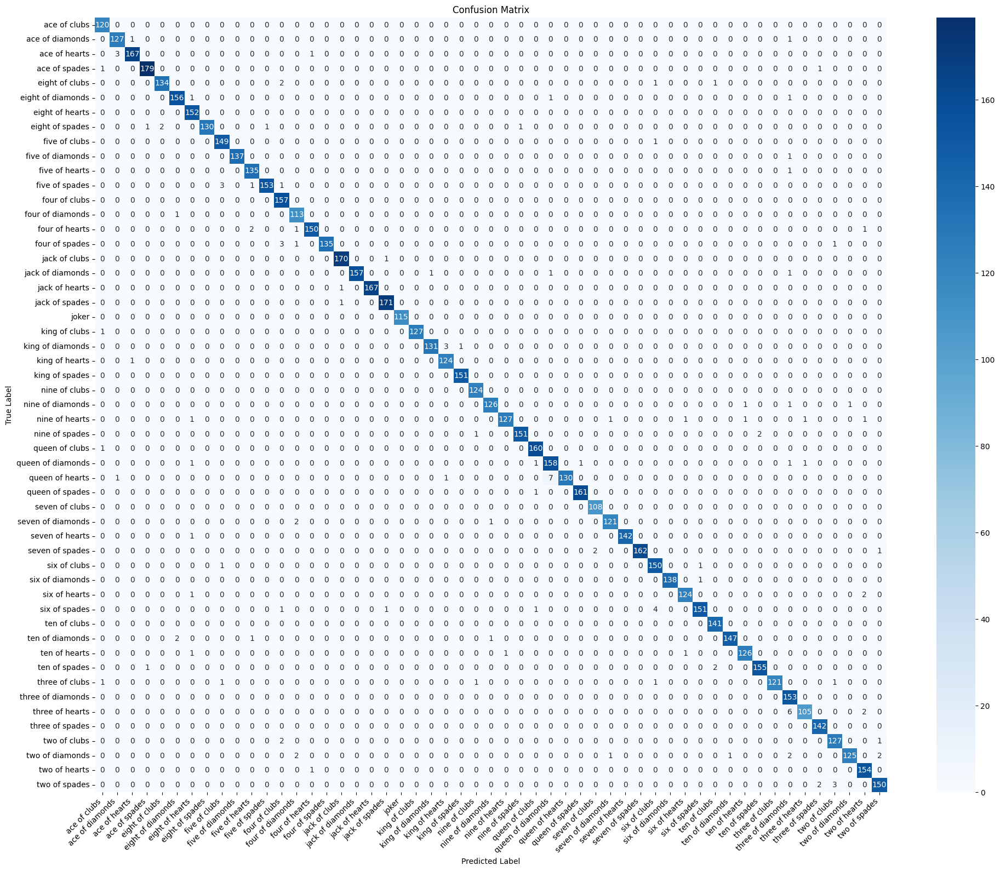

In [42]:
plot_confusion_matrix(confusion_mtx, class_labels)

100%|██████████| 239/239 [04:07<00:00,  1.03s/it]


Number of incorrect predictions: 138
Total Number of Predictions: 7624
Accuracy: 98.19%


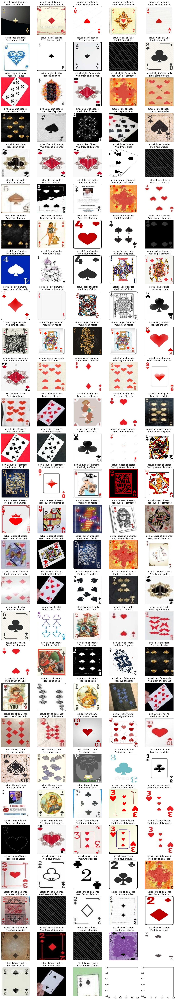

In [43]:
display_incorrect_predictions(
    model=model_1,
    data_loader=train_loader,
    class_names=class_labels,
    device=device
)

### Model 2

#### Test data

In [44]:
all_preds, all_labels = get_prediction(test_loader, model_2)

In [45]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

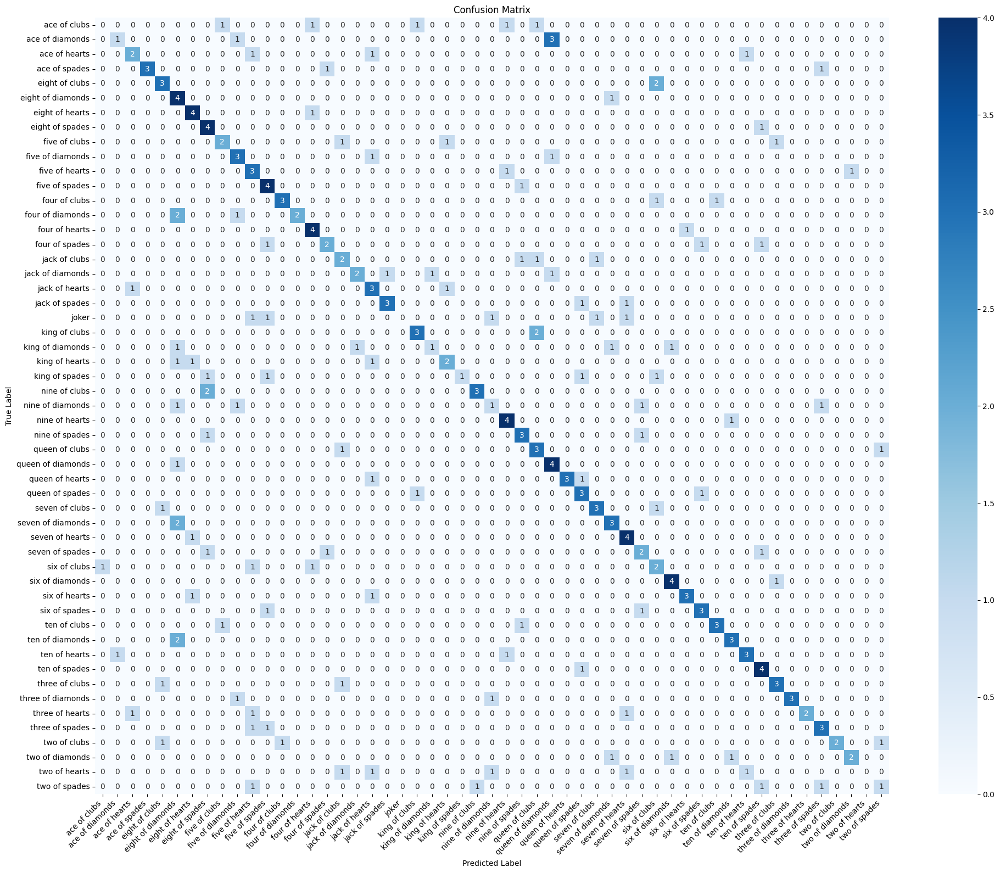

In [46]:
plot_confusion_matrix(confusion_mtx, class_labels)

100%|██████████| 9/9 [00:07<00:00,  1.19it/s]


Number of incorrect predictions: 37
Total Number of Predictions: 265
Accuracy: 86.04%


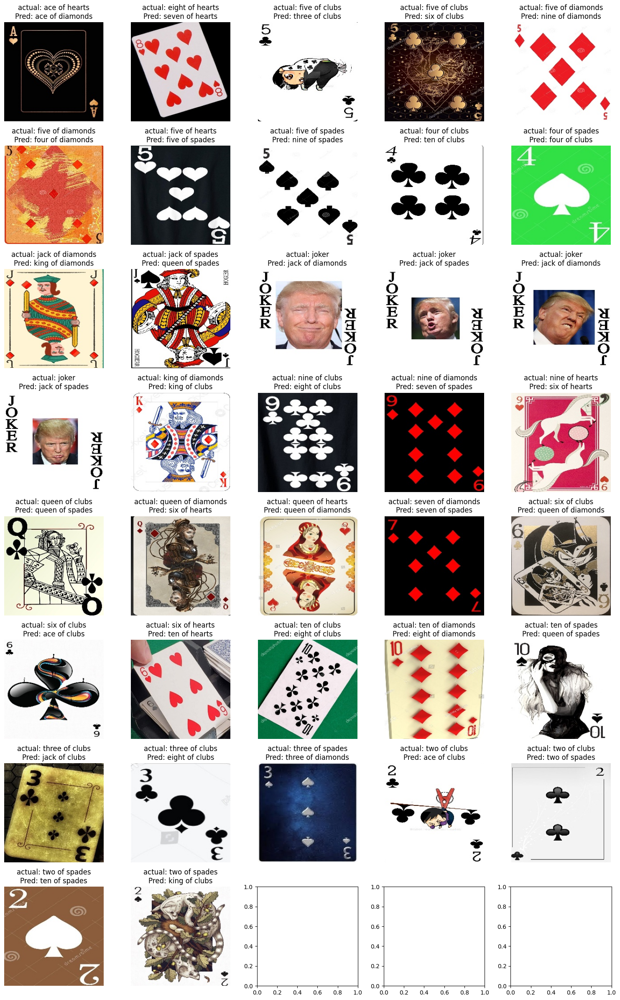

In [47]:
display_incorrect_predictions(
    model=model_2,
    data_loader=test_loader,
    class_names=class_labels,
    device=device
)

#### Validation data

In [48]:
all_preds, all_labels = get_prediction(valid_loader, model_2)

In [49]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

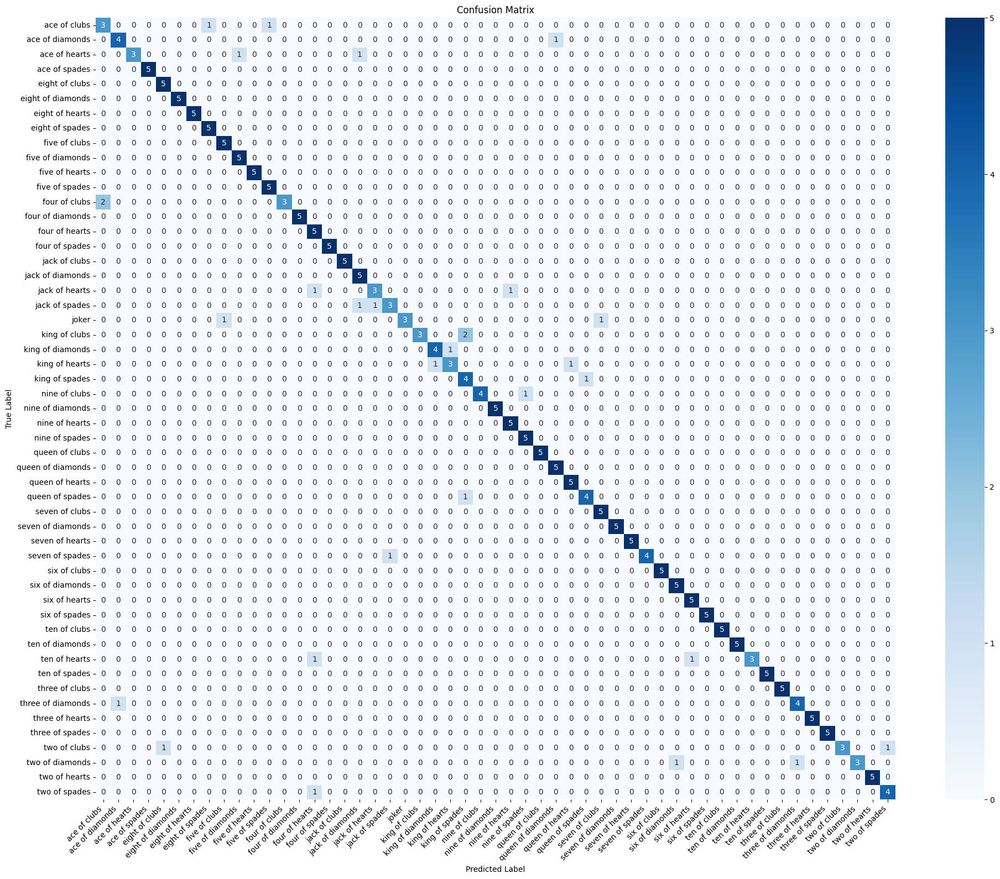

In [50]:
plot_confusion_matrix(confusion_mtx, class_labels)

100%|██████████| 9/9 [00:07<00:00,  1.14it/s]


Number of incorrect predictions: 30
Total Number of Predictions: 265
Accuracy: 88.68%


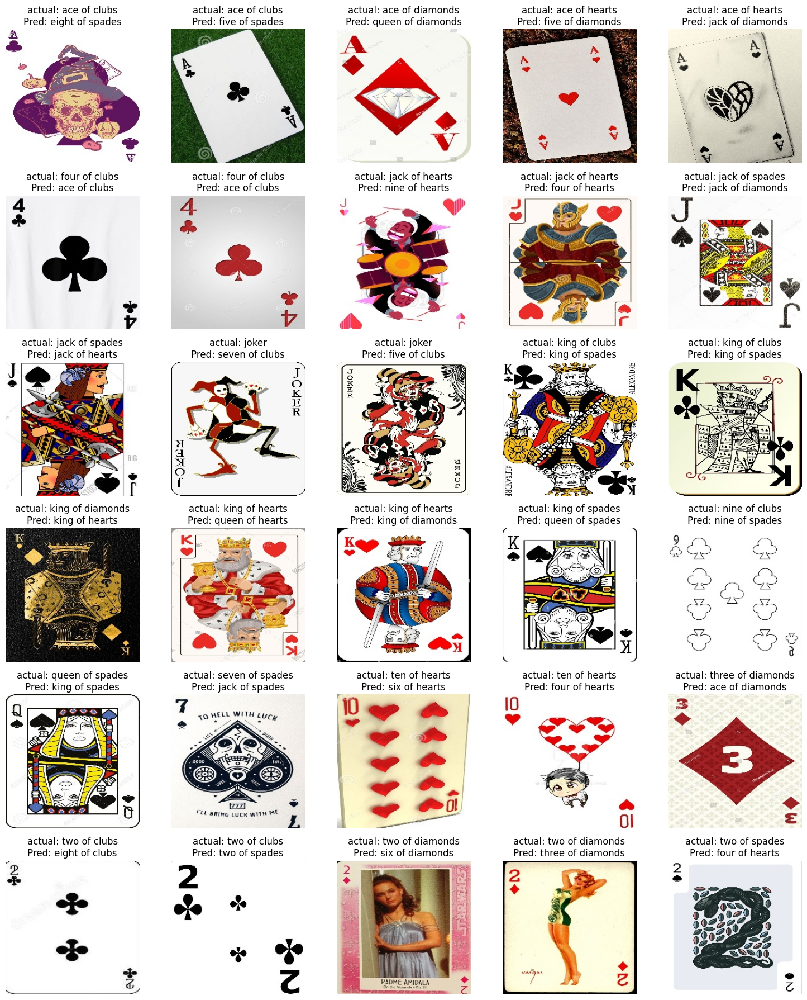

In [51]:
display_incorrect_predictions(
    model=model_2,
    data_loader=valid_loader,
    class_names=class_labels,
    device=device
)

#### Training data

In [52]:
all_preds, all_labels = get_prediction(train_loader, model_2)

In [53]:
confusion_mtx = confusion_matrix(all_labels, all_preds)

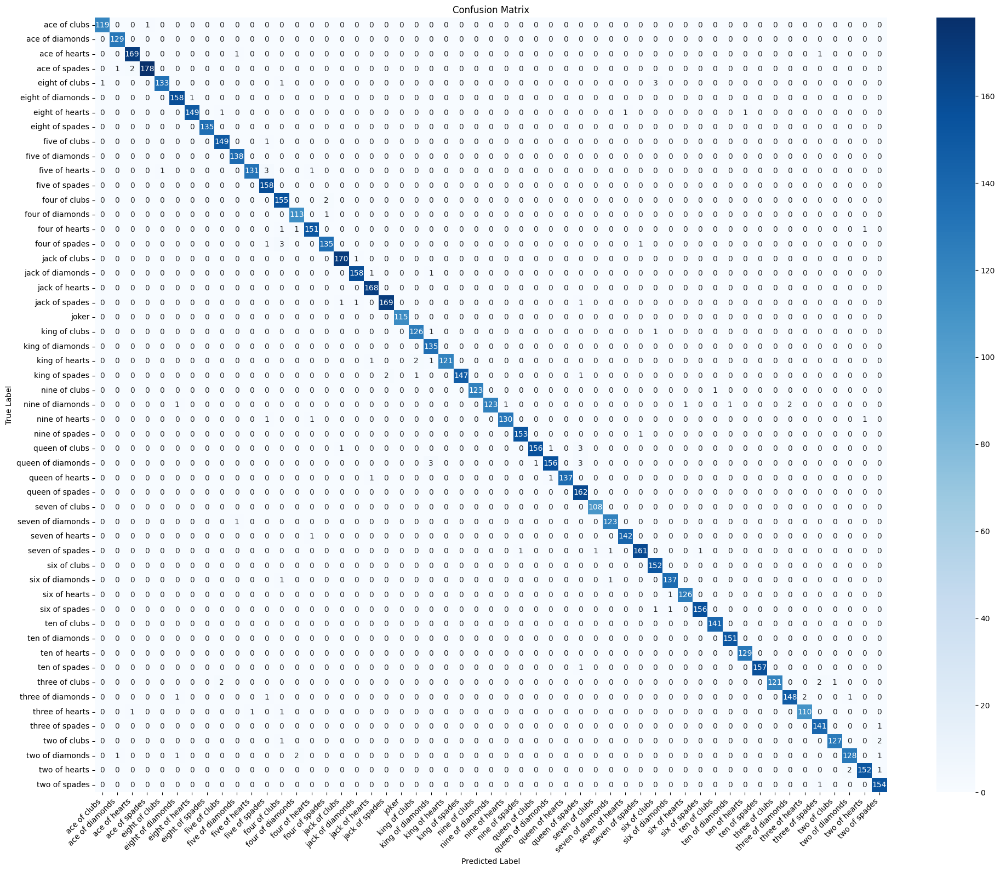

In [54]:
plot_confusion_matrix(confusion_mtx, class_labels)

100%|██████████| 239/239 [03:50<00:00,  1.04it/s]


Number of incorrect predictions: 111
Total Number of Predictions: 7624
Accuracy: 98.54%


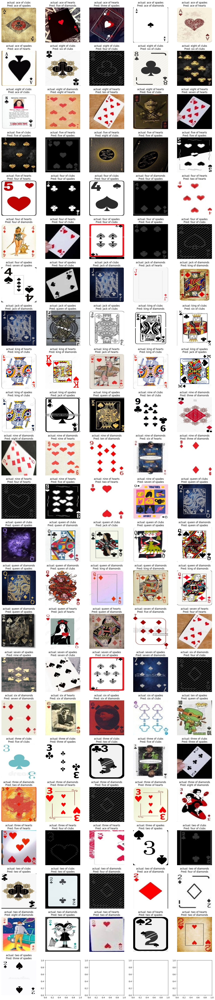

In [55]:
display_incorrect_predictions(
    model=model_2,
    data_loader=train_loader,
    class_names=class_labels,
    device=device
)

### Extensive prediction custom test data

In [56]:
extensive_test_dir = "/kaggle/input/deck-of-cards/extensive_test_data"

Accuracy: 90.00%


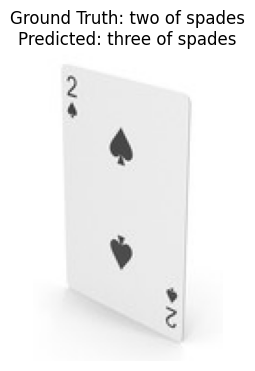

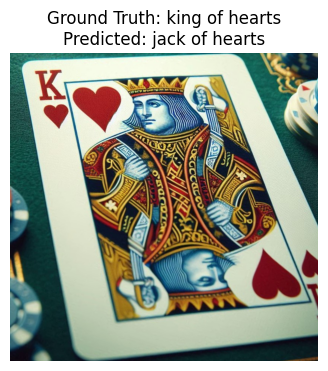

In [57]:
# Classify images and calculate accuracy
accuracy, incorrect_preds = classify_images_in_folder(model_1, extensive_test_dir, class_labels, data_transform, device)

# Display incorrectly predicted images
display_incorrect_predictions_in_folder(incorrect_preds)

Accuracy: 85.00%


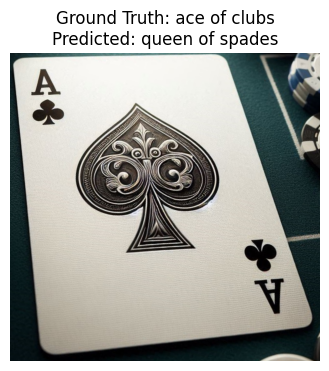

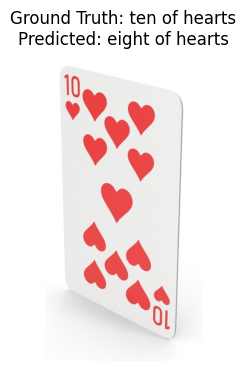

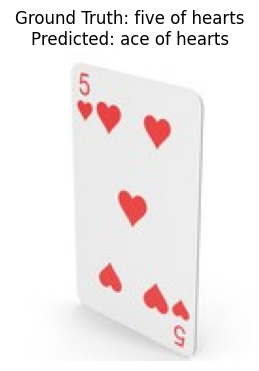

In [58]:
# Classify images and calculate accuracy
accuracy, incorrect_preds = classify_images_in_folder(model_2, extensive_test_dir, class_labels, data_transform, device)

# Display incorrectly predicted images
display_incorrect_predictions_in_folder(incorrect_preds)